<a href="https://colab.research.google.com/github/Roon311/NLP/blob/main/NLP_Sentiment_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![logo](https://drive.google.com/uc?export=view&id=1QJ9PAT9q-Ksv_Vs_pLXtLHxjjV-9FMTz)



_Prepared by_  [**Noureldin Mohamed Abdelsalam**](mailto:s-noureldin.hamedo@zewailcity.edu.eg)

<h1><b>ASSIGNMENT 2: Twitter Sentiment Analysis using CNN<b></h1>

# Table of Contents

- [Introduction](#scrollTo=Qz6WWGgn7vBJ)
- [Loading the Data](#scrollTo=5DrdU1UmKj-2)
- [Imports](#scrollTo=jKtQcCNjLn1f)
- [Preparing the Dataframe](#scrollTo=3fRVNjl4L0IQ)
- [Explatory Data Analysis](#scrollTo=4IA-j6yCNLb_)
- [Natural Language Processing](#scrollTo=pXgGLf9gOE3Z&uniqifier=2)


# **Introduction**
<h3><b>Word2Vec Embeddings</b></h2>

*  <font color=gren><b>Continuous Bag of Words:</b></font> predict the center words given the neighbor words.

<img src="https://amitness.com/images/nlp-ssl-center-word-prediction.gif" width="600">

*  <font color=gren><b>Skip-gram</b></font> :predict the neighbor words given a center word.

<img src="https://amitness.com/images/nlp-ssl-neighbor-word-prediction.gif" width="600">

<h3><b>Word2Vec Limitations</b></h2>

*  <font color=gren><b>Out of Vocabulary(OOV) Words:</b></font>can't handle any words it has not encountered during its training.

<img src="https://amitness.com/images/word2vec-oov-tensorflow.png" width="600">

*  <font color=gren><b>Morphology:</b></font>It doesn't do any parameter sharing.Each word is learned uniquely based on the context it appears in.

<img src="https://amitness.com/images/word2vec-radicals.png" width="600">

# **1.Load the Dataset**

In [1]:
! pip install -q kaggle
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [2]:
!kaggle datasets download -d saurabhshahane/twitter-sentiment-dataset

  0% 0.00/7.60M [00:00<?, ?B/s]
100% 7.60M/7.60M [00:00<00:00, 103MB/s]


In [3]:
!unzip twitter-sentiment-dataset.zip

Archive:  twitter-sentiment-dataset.zip
  inflating: Twitter_Data.csv        


#**2.Imports**

In [4]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import re

from gensim.models import Word2Vec

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

from keras.models import Sequential
import tensorflow as tf
from tensorflow.keras.layers import Embedding, Conv1D, GlobalMaxPooling1D, Dense, Input
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('punkt')

nltk.download('stopwords')

nltk.download('wordnet')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

#**3.Preparing the Dataframe**

In [5]:
df=pd.read_csv('Twitter_Data.csv')
df

,clean_text,category
0,when modi promised “minimum government maximum...,-1.0
1,talk all the nonsense and continue all the dra...,0.0
2,what did just say vote for modi welcome bjp t...,1.0
3,asking his supporters prefix chowkidar their n...,1.0
4,answer who among these the most powerful world...,1.0
...,...,...
162975,why these 456 crores paid neerav modi not reco...,-1.0
162976,dear rss terrorist payal gawar what about modi...,-1.0
162977,did you cover her interaction forum where she ...,0.0
162978,there big project came into india modi dream p...,0.0


#**4.Explatory Data Analysis**

Lets begin by displaying some information about the data

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 162980 entries, 0 to 162979
Data columns (total 2 columns):
 #   Column      Non-Null Count   Dtype  
---  ------      --------------   -----  
 0   clean_text  162976 non-null  object 
 1   category    162973 non-null  float64
dtypes: float64(1), object(1)
memory usage: 2.5+ MB


The data consists of 2 columns. The first column is <font color=gren>clean_text</font> and the second column is <font color=gren>category</font>.

Lets what types of categories do we have.

In [ ]:
category_counts=df['category'].value_counts()
category_counts

 1.0    72250
 0.0    55213
-1.0    35510
Name: category, dtype: int64

The dataset has three sentiments namely, negative(-1), neutral(0), and positive(+1).

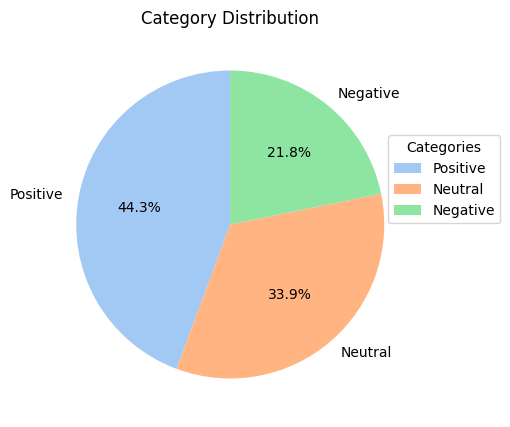

In [ ]:
sentiment_mapping = {-1: 'Negative', 0: 'Neutral', 1: 'Positive'}
df['sentiment_label'] = df['category'].map(sentiment_mapping)

plt.figure(figsize=(10, 5))
sns.set_palette("pastel")
plt.title('Category Distribution')
pie_chart = plt.pie(df['sentiment_label'].value_counts(), labels=df['sentiment_label'].value_counts().index, autopct='%1.1f%%', startangle=90)
plt.legend(pie_chart[0], df['sentiment_label'].value_counts().index, title='Categories', loc='upper right', bbox_to_anchor=(1.22, .75))
plt.show()

## **4.2 Checking for Nulls**

In [6]:
df.isna().sum()

clean_text    4
category      7
dtype: int64

In [7]:
df.dropna(inplace=True)

In [8]:
df.isna().sum()

clean_text    0
category      0
dtype: int64

## **4.3 Checking for Duplicates**

In [9]:
df.duplicated().sum()

0

## **Visualizing the Word Cloud for Positive Reviews**

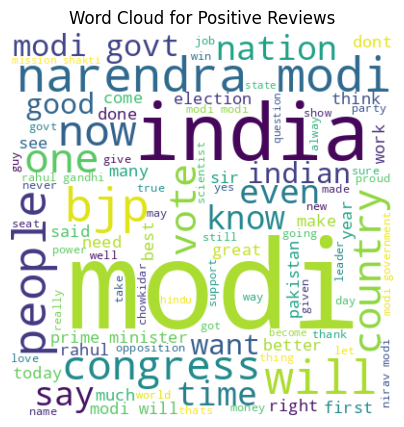

In [30]:
from wordcloud import WordCloud
wc = WordCloud(width=400, height=400, min_font_size=10, background_color='white')
wordcloud = wc.generate(' '.join(df[df['category'] == 1.0]['clean_text']))

plt.figure(figsize=(5, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.title('Word Cloud for Positive Reviews')
plt.axis('off')
plt.show()

# **5.Natural Language Processing**

## **Embedding the Text**

In [ ]:
clean_text=df['clean_text']
clean_text

0         when modi promised “minimum government maximum...
1         talk all the nonsense and continue all the dra...
2         what did just say vote for modi  welcome bjp t...
3         asking his supporters prefix chowkidar their n...
4         answer who among these the most powerful world...
                                ...                        
162975    why these 456 crores paid neerav modi not reco...
162976    dear rss terrorist payal gawar what about modi...
162977    did you cover her interaction forum where she ...
162978    there big project came into india modi dream p...
162979    have you ever listen about like gurukul where ...
Name: clean_text, Length: 162969, dtype: object

In [ ]:
def make_clean_text(text):


    stop_words = set(stopwords.words('english'))

    lemmatizer = WordNetLemmatizer()

    text = re.sub(r'\W', ' ', text) # Remove extra whitespaces

    text = re.sub(r'[^a-zA-Z\s]', '', text) # Remove all special characters


    text = ' '.join(word for word in text.split() if len(word) > 1)# Remove all single characters

    text=text.lower()

    tokens = word_tokenize(text)

    tokens = [lemmatizer.lemmatize(word) for word in tokens]


    tokens = [word for word in tokens if word.lower() not in stop_words]

    return tokens

In [ ]:
tokenized_text=clean_text.apply(make_clean_text)

In [ ]:
tokenized_text

0         [modi, promised, minimum, government, maximum,...
1             [talk, nonsense, continue, drama, vote, modi]
2         [say, vote, modi, welcome, bjp, told, rahul, m...
3         [asking, supporter, prefix, chowkidar, name, m...
4         [answer, among, powerful, world, leader, today...
                                ...                        
162975    [crore, paid, neerav, modi, recovered, congres...
162976    [dear, r, terrorist, payal, gawar, modi, killi...
162977                    [cover, interaction, forum, left]
162978    [big, project, came, india, modi, dream, proje...
162979    [ever, listen, like, gurukul, discipline, main...
Name: clean_text, Length: 162969, dtype: object

In [ ]:
df_tokenized = pd.DataFrame({'tokenized_text': tokenized_text, 'label': df['category']})
df_tokenized=df_tokenized
df_tokenized

,tokenized_text,label
0,"[modi, promised, minimum, government, maximum,...",-1.0
1,"[talk, nonsense, continue, drama, vote, modi]",0.0
2,"[say, vote, modi, welcome, bjp, told, rahul, m...",1.0
3,"[asking, supporter, prefix, chowkidar, name, m...",1.0
4,"[answer, among, powerful, world, leader, today...",1.0
...,...,...
162975,"[crore, paid, neerav, modi, recovered, congres...",-1.0
162976,"[dear, r, terrorist, payal, gawar, modi, killi...",-1.0
162977,"[cover, interaction, forum, left]",0.0
162978,"[big, project, came, india, modi, dream, proje...",0.0


In [ ]:
X = df_tokenized['tokenized_text'].values
X

array([list(['modi', 'promised', 'minimum', 'government', 'maximum', 'governance', 'expected', 'begin', 'difficult', 'job', 'reforming', 'state', 'doe', 'take', 'year', 'get', 'justice', 'state', 'business', 'exit', 'psus', 'temple']),
       list(['talk', 'nonsense', 'continue', 'drama', 'vote', 'modi']),
       list(['say', 'vote', 'modi', 'welcome', 'bjp', 'told', 'rahul', 'main', 'campaigner', 'modi', 'think', 'modi', 'relax']),
       ..., list(['cover', 'interaction', 'forum', 'left']),
       list(['big', 'project', 'came', 'india', 'modi', 'dream', 'project', 'happened', 'reality']),
       list(['ever', 'listen', 'like', 'gurukul', 'discipline', 'maintained', 'even', 'narendra', 'modi', 'r', 'maintaining', 'culture', 'indian', 'attack', 'politics', 'someone', 'attack', 'hinduism', 'r', 'take', 'action', 'proud'])],
      dtype=object)

In [ ]:
y = df_tokenized['label'].values
y

array([-1.,  0.,  1., ...,  0.,  0.,  1.])

In [ ]:
le = LabelEncoder()
y = le.fit_transform(y)
y

array([0, 1, 2, ..., 1, 1, 2])

In [ ]:
word2vec_model = Word2Vec(sentences=X, vector_size=100, window=5, min_count=1, workers=4)


In [ ]:
X_seq = [[word2vec_model.wv[word] for word in sentence] for sentence in X]
X_seq

[[array([ 0.07543878,  0.46781793,  0.36978066,  0.29183596, -0.2756243 ,
         -2.4701672 ,  0.1076079 ,  0.69071436, -1.1566595 ,  0.19374639,
          1.528308  , -0.10335509,  0.3803695 ,  0.09418108, -0.06553627,
         -0.00560929,  0.5034508 ,  0.5511089 , -2.100895  , -1.1137831 ,
         -0.38634682,  1.3453296 ,  1.2363664 , -1.4994408 ,  0.8495059 ,
          3.2467723 , -0.0065207 , -0.4952761 , -1.1344328 , -0.4938577 ,
          0.03374839,  0.5962445 ,  1.1975315 , -1.3956656 , -0.21237187,
          0.6311043 , -0.15855274,  0.4002828 ,  0.2949994 , -1.3458911 ,
         -0.6362349 ,  0.33106178, -1.3442765 , -0.44099182,  0.29682654,
         -1.4561899 , -0.8486542 ,  0.74243253,  0.38562283,  1.0708348 ,
          0.27243415,  0.47197452,  1.1206349 ,  1.5946155 , -1.1546576 ,
          0.4078729 ,  0.83474517,  0.02726686, -0.9814501 ,  0.7286906 ,
          1.0167469 ,  0.39760944, -1.887666  , -0.80372894, -0.21037042,
         -0.09654612, -0.31458685,  0.

Lets now run on different parameters, and select the best parameter

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_seq, y, test_size=0.2, random_state=42)

# Pad sequences to have the same length
max_len = max(len(seq) for seq in X_seq)
X_train_seq = pad_sequences(X_train, maxlen=max_len, padding='post')
X_test_seq = pad_sequences(X_test, maxlen=max_len, padding='post')


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
np.save('/content/drive/MyDrive/zetsobu_drive/X_train_seq.npy', X_train_seq)
np.save('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy', X_test_seq)

In [ ]:
np.save('/content/drive/MyDrive/zetsobu_drive/y_train.npy', y_train)
np.save('/content/drive/MyDrive/zetsobu_drive/y_test.npy', y_test)

# Reopen the session (Dealing with small RAM)

In [ ]:
X_train_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_train_seq.npy')
X_test_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy')
y_train_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_train.npy')
y_test_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_test.npy')

In [ ]:
max_len=43

Epoch 1/10
2038/2038 [==============================] - 23s 6ms/step - loss: 0.8687 - accuracy: 0.5931 - val_loss: 0.7868 - val_accuracy: 0.6476
Epoch 2/10
2038/2038 [==============================] - 13s 7ms/step - loss: 0.7568 - accuracy: 0.6676 - val_loss: 0.7432 - val_accuracy: 0.6737
Epoch 3/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.7338 - accuracy: 0.6813 - val_loss: 0.7301 - val_accuracy: 0.6790
Epoch 4/10
2038/2038 [==============================] - 10s 5ms/step - loss: 0.7214 - accuracy: 0.6879 - val_loss: 0.7253 - val_accuracy: 0.6866
Epoch 5/10
2038/2038 [==============================] - 10s 5ms/step - loss: 0.7136 - accuracy: 0.6929 - val_loss: 0.7169 - val_accuracy: 0.6949
Epoch 6/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7065 - accuracy: 0.6971 - val_loss: 0.7113 - val_accuracy: 0.6928
Epoch 7/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7012 - accuracy: 0.6999 - val_loss: 0.7113 - val_ac

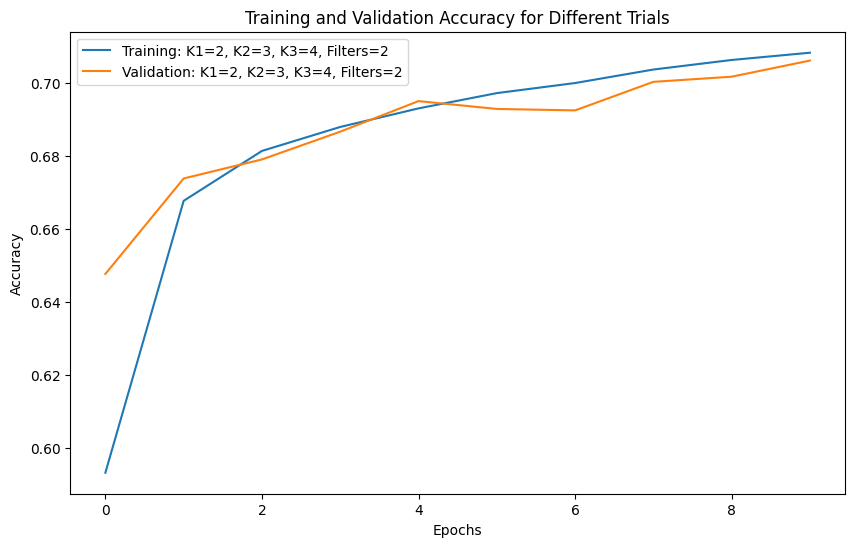

In [ ]:
kernel_sizes1 = [2]
kernel_sizes2 = [3]
kernel_sizes3 = [4]

num_filters_list = [2]

results = []

plt.figure(figsize=(10, 6))

for kernel_size1, kernel_size2, kernel_size3 in zip(kernel_sizes1, kernel_sizes2, kernel_sizes3):
    for num_filters in num_filters_list:
        input_layer = Input(shape=(max_len, 100))

        conv_2 = Conv1D(filters=2, kernel_size=kernel_size1, activation='relu')(input_layer)
        pool_2 = GlobalMaxPooling1D()(conv_2)

        conv_3 = Conv1D(filters=2, kernel_size=kernel_size2, activation='relu')(input_layer)
        pool_3 = GlobalMaxPooling1D()(conv_3)

        conv_4 = Conv1D(filters=2, kernel_size=kernel_size3, activation='relu')(input_layer)
        pool_4 = GlobalMaxPooling1D()(conv_4)

        concatenated = tf.keras.layers.Concatenate(axis=1)([pool_2, pool_3, pool_4])

        output_layer = Dense(3, activation='softmax')(concatenated)

        model = Model(inputs=input_layer, outputs=output_layer)

        model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

        history = model.fit(X_train_seq_loaded, y_train_loaded, epochs=10, batch_size=64, validation_data=(X_test_seq_loaded, y_test_loaded))

        plt.plot(history.history['accuracy'], label=f'Training: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')
        plt.plot(history.history['val_accuracy'], label=f'Validation: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')

plt.title('Training and Validation Accuracy for Different Trials')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


Mounted at /content/drive
Epoch 1/10
2038/2038 [==============================] - 24s 6ms/step - loss: 0.8951 - accuracy: 0.5904 - val_loss: 0.7873 - val_accuracy: 0.6553
Epoch 2/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7530 - accuracy: 0.6740 - val_loss: 0.7361 - val_accuracy: 0.6826
Epoch 3/10
2038/2038 [==============================] - 14s 7ms/step - loss: 0.7177 - accuracy: 0.6940 - val_loss: 0.7111 - val_accuracy: 0.6970
Epoch 4/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.6946 - accuracy: 0.7079 - val_loss: 0.6917 - val_accuracy: 0.7099
Epoch 5/10
2038/2038 [==============================] - 10s 5ms/step - loss: 0.6806 - accuracy: 0.7163 - val_loss: 0.6865 - val_accuracy: 0.7123
Epoch 6/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6706 - accuracy: 0.7230 - val_loss: 0.6786 - val_accuracy: 0.7169
Epoch 7/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6627 - accuracy: 0.7281 -

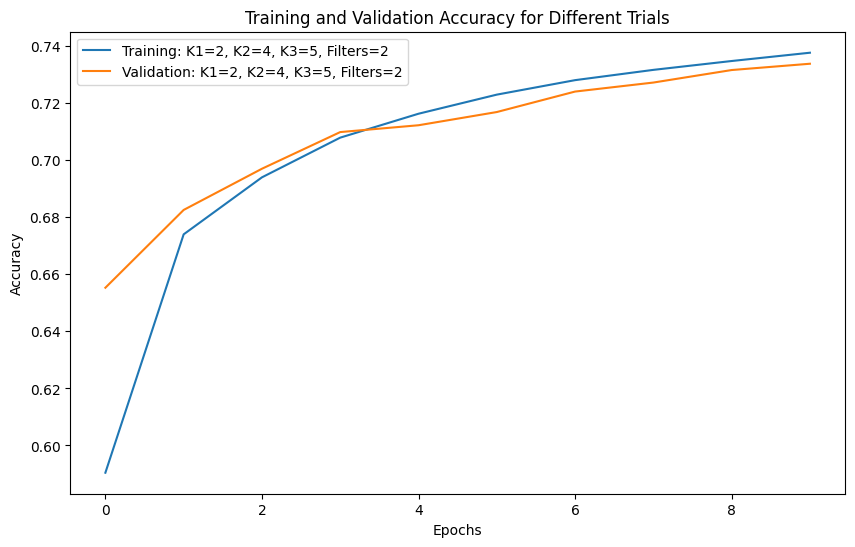

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import re

from gensim.models import Word2Vec

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

from keras.models import Sequential
import tensorflow as tf
from tensorflow.keras.layers import Embedding, Conv1D, GlobalMaxPooling1D, Dense, Input
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('punkt')

nltk.download('stopwords')

nltk.download('wordnet')

from google.colab import drive
drive.mount('/content/drive')

X_train_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_train_seq.npy')
X_test_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy')
y_train_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_train.npy')
y_test_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_test.npy')
max_len=43

kernel_sizes1 = [2]
kernel_sizes2 = [4]
kernel_sizes3 = [5]

num_filters_list = [2]

results = []

plt.figure(figsize=(10, 6))

for kernel_size1, kernel_size2, kernel_size3 in zip(kernel_sizes1, kernel_sizes2, kernel_sizes3):
    for num_filters in num_filters_list:
        input_layer = Input(shape=(max_len, 100))

        conv_2 = Conv1D(filters=2, kernel_size=kernel_size1, activation='relu')(input_layer)
        pool_2 = GlobalMaxPooling1D()(conv_2)

        conv_3 = Conv1D(filters=2, kernel_size=kernel_size2, activation='relu')(input_layer)
        pool_3 = GlobalMaxPooling1D()(conv_3)

        conv_4 = Conv1D(filters=2, kernel_size=kernel_size3, activation='relu')(input_layer)
        pool_4 = GlobalMaxPooling1D()(conv_4)

        concatenated = tf.keras.layers.Concatenate(axis=1)([pool_2, pool_3, pool_4])

        output_layer = Dense(3, activation='softmax')(concatenated)

        model = Model(inputs=input_layer, outputs=output_layer)

        model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

        history = model.fit(X_train_seq_loaded, y_train_loaded, epochs=10, batch_size=64, validation_data=(X_test_seq_loaded, y_test_loaded))

        plt.plot(history.history['accuracy'], label=f'Training: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')
        plt.plot(history.history['val_accuracy'], label=f'Validation: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')

plt.title('Training and Validation Accuracy for Different Trials')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


Epoch 1/10
2038/2038 [==============================] - 27s 10ms/step - loss: 0.8445 - accuracy: 0.6114 - val_loss: 0.7694 - val_accuracy: 0.6619
Epoch 2/10
2038/2038 [==============================] - 18s 9ms/step - loss: 0.7413 - accuracy: 0.6773 - val_loss: 0.7362 - val_accuracy: 0.6804
Epoch 3/10
2038/2038 [==============================] - 15s 7ms/step - loss: 0.7159 - accuracy: 0.6924 - val_loss: 0.7238 - val_accuracy: 0.6890
Epoch 4/10
2038/2038 [==============================] - 13s 7ms/step - loss: 0.6985 - accuracy: 0.7030 - val_loss: 0.7046 - val_accuracy: 0.7002
Epoch 5/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.6826 - accuracy: 0.7131 - val_loss: 0.6883 - val_accuracy: 0.7092
Epoch 6/10
2038/2038 [==============================] - 13s 6ms/step - loss: 0.6694 - accuracy: 0.7223 - val_loss: 0.6773 - val_accuracy: 0.7181
Epoch 7/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6583 - accuracy: 0.7293 - val_loss: 0.6687 - val_a

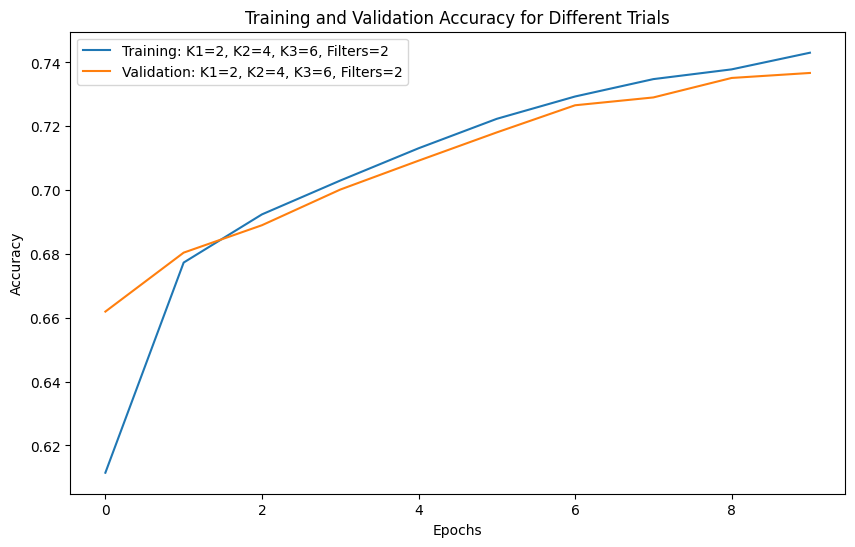

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import re

from gensim.models import Word2Vec

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

from keras.models import Sequential
import tensorflow as tf
from tensorflow.keras.layers import Embedding, Conv1D, GlobalMaxPooling1D, Dense, Input
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('punkt')

nltk.download('stopwords')

nltk.download('wordnet')


X_train_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_train_seq.npy')
X_test_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy')
y_train_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_train.npy')
y_test_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_test.npy')
max_len=43

kernel_sizes1 = [2]
kernel_sizes2 = [4]
kernel_sizes3 = [6]

num_filters_list = [2]

results = []

plt.figure(figsize=(10, 6))

for kernel_size1, kernel_size2, kernel_size3 in zip(kernel_sizes1, kernel_sizes2, kernel_sizes3):
    for num_filters in num_filters_list:
        input_layer = Input(shape=(max_len, 100))

        conv_2 = Conv1D(filters=2, kernel_size=kernel_size1, activation='relu')(input_layer)
        pool_2 = GlobalMaxPooling1D()(conv_2)

        conv_3 = Conv1D(filters=2, kernel_size=kernel_size2, activation='relu')(input_layer)
        pool_3 = GlobalMaxPooling1D()(conv_3)

        conv_4 = Conv1D(filters=2, kernel_size=kernel_size3, activation='relu')(input_layer)
        pool_4 = GlobalMaxPooling1D()(conv_4)

        concatenated = tf.keras.layers.Concatenate(axis=1)([pool_2, pool_3, pool_4])

        output_layer = Dense(3, activation='softmax')(concatenated)

        model = Model(inputs=input_layer, outputs=output_layer)

        model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

        history = model.fit(X_train_seq_loaded, y_train_loaded, epochs=10, batch_size=64, validation_data=(X_test_seq_loaded, y_test_loaded))

        plt.plot(history.history['accuracy'], label=f'Training: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')
        plt.plot(history.history['val_accuracy'], label=f'Validation: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')

plt.title('Training and Validation Accuracy for Different Trials')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import re

from gensim.models import Word2Vec

from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

from keras.models import Sequential
import tensorflow as tf
from tensorflow.keras.layers import Embedding, Conv1D, GlobalMaxPooling1D, Dense, Input
from tensorflow.keras.models import Model
from tensorflow.keras.preprocessing.sequence import pad_sequences

import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

from google.colab import drive
drive.mount('/content/drive')

def train_and_plot_model(kernel_sizes1, kernel_sizes2, kernel_sizes3, num_filters_list):
    X_train_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_train_seq.npy')
    X_test_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy')
    y_train_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_train.npy')
    y_test_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_test.npy')
    max_len = 43

    plt.figure(figsize=(10, 6))

    for kernel_size1, kernel_size2, kernel_size3 in zip(kernel_sizes1, kernel_sizes2, kernel_sizes3):
        for num_filters in num_filters_list:
            input_layer = Input(shape=(max_len, 100))

            conv_2 = Conv1D(filters=2, kernel_size=kernel_size1, activation='relu')(input_layer)
            pool_2 = GlobalMaxPooling1D()(conv_2)

            conv_3 = Conv1D(filters=2, kernel_size=kernel_size2, activation='relu')(input_layer)
            pool_3 = GlobalMaxPooling1D()(conv_3)

            conv_4 = Conv1D(filters=2, kernel_size=kernel_size3, activation='relu')(input_layer)
            pool_4 = GlobalMaxPooling1D()(conv_4)

            concatenated = tf.keras.layers.Concatenate(axis=1)([pool_2, pool_3, pool_4])

            output_layer = Dense(3, activation='softmax')(concatenated)

            model = Model(inputs=input_layer, outputs=output_layer)

            model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

            history = model.fit(X_train_seq_loaded, y_train_loaded, epochs=10, batch_size=64, validation_data=(X_test_seq_loaded, y_test_loaded))

            plt.plot(history.history['accuracy'], label=f'Training: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')
            plt.plot(history.history['val_accuracy'], label=f'Validation: K1={kernel_size1}, K2={kernel_size2}, K3={kernel_size3}, Filters={num_filters}')


    plt.title('Training and Validation Accuracy for Different Trials')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()
    return model



[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


Mounted at /content/drive


Epoch 1/10
2038/2038 [==============================] - 23s 7ms/step - loss: 0.8621 - accuracy: 0.5994 - val_loss: 0.7909 - val_accuracy: 0.6451
Epoch 2/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.7599 - accuracy: 0.6666 - val_loss: 0.7482 - val_accuracy: 0.6727
Epoch 3/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7288 - accuracy: 0.6856 - val_loss: 0.7279 - val_accuracy: 0.6844
Epoch 4/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7095 - accuracy: 0.6961 - val_loss: 0.7099 - val_accuracy: 0.6986
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6958 - accuracy: 0.7061 - val_loss: 0.6957 - val_accuracy: 0.7083
Epoch 6/10
2038/2038 [==============================] - 10s 5ms/step - loss: 0.6837 - accuracy: 0.7144 - val_loss: 0.6872 - val_accuracy: 0.7124
Epoch 7/10
2038/2038 [==============================] - 20s 10ms/step - loss: 0.6747 - accuracy: 0.7205 - val_loss: 0.6815 - val_a

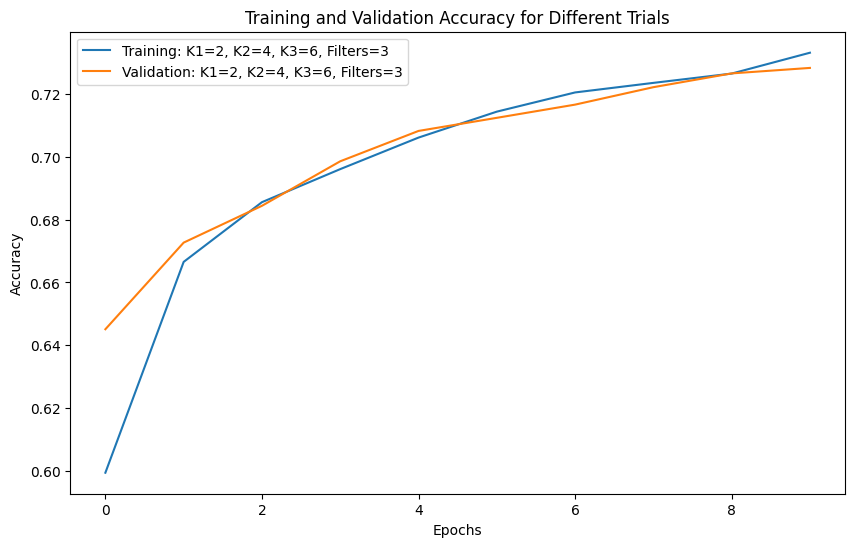

In [ ]:
train_and_plot_model(kernel_sizes1 = [2], kernel_sizes2 = [4], kernel_sizes3 = [6], num_filters_list = [3])

Epoch 1/10
2038/2038 [==============================] - 18s 6ms/step - loss: 0.8818 - accuracy: 0.5929 - val_loss: 0.7977 - val_accuracy: 0.6477
Epoch 2/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7684 - accuracy: 0.6630 - val_loss: 0.7563 - val_accuracy: 0.6696
Epoch 3/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.7386 - accuracy: 0.6806 - val_loss: 0.7342 - val_accuracy: 0.6822
Epoch 4/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7207 - accuracy: 0.6913 - val_loss: 0.7250 - val_accuracy: 0.6877
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7090 - accuracy: 0.6983 - val_loss: 0.7151 - val_accuracy: 0.6928
Epoch 6/10
2038/2038 [==============================] - 13s 7ms/step - loss: 0.6998 - accuracy: 0.7027 - val_loss: 0.7139 - val_accuracy: 0.6977
Epoch 7/10
2038/2038 [==============================] - 14s 7ms/step - loss: 0.6924 - accuracy: 0.7082 - val_loss: 0.7061 - val_ac

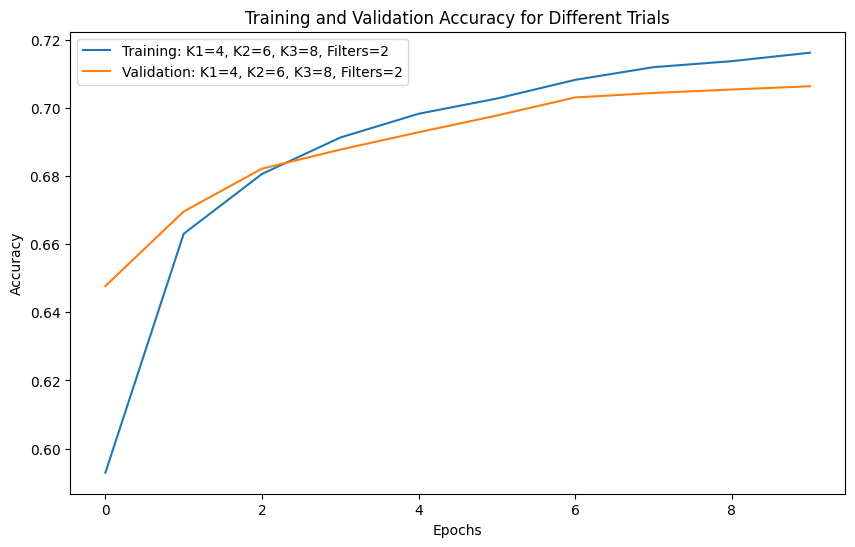

In [ ]:
train_and_plot_model(kernel_sizes1 = [4], kernel_sizes2 = [6], kernel_sizes3 = [8], num_filters_list = [2])

Epoch 1/10
2038/2038 [==============================] - 15s 6ms/step - loss: 0.9511 - accuracy: 0.5462 - val_loss: 0.8710 - val_accuracy: 0.5943
Epoch 2/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.8445 - accuracy: 0.6077 - val_loss: 0.8287 - val_accuracy: 0.6163
Epoch 3/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.8095 - accuracy: 0.6257 - val_loss: 0.8056 - val_accuracy: 0.6267
Epoch 4/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7837 - accuracy: 0.6423 - val_loss: 0.7817 - val_accuracy: 0.6463
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7620 - accuracy: 0.6547 - val_loss: 0.7658 - val_accuracy: 0.6564
Epoch 6/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7447 - accuracy: 0.6667 - val_loss: 0.7476 - val_accuracy: 0.6699
Epoch 7/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.7295 - accuracy: 0.6784 - val_loss: 0.7359 - val_ac

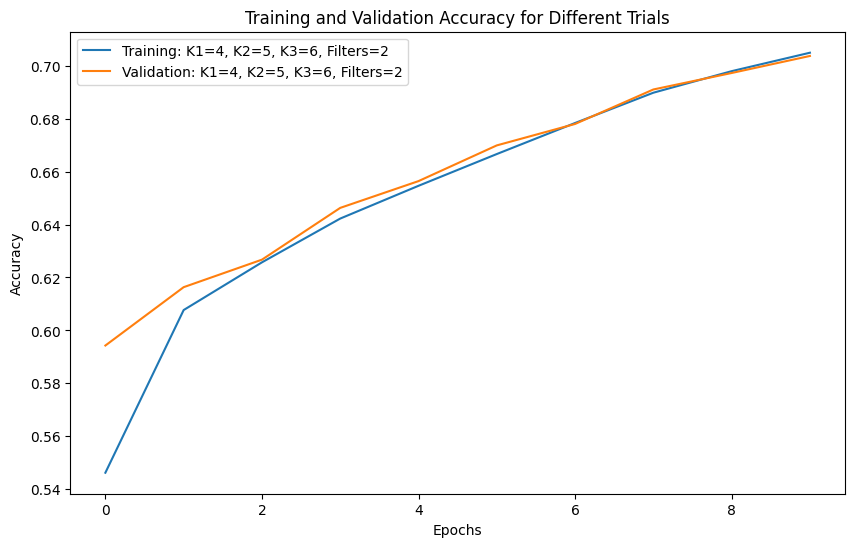

In [ ]:
train_and_plot_model(kernel_sizes1 = [4], kernel_sizes2 = [5], kernel_sizes3 = [6], num_filters_list = [2])

Epoch 1/10
2038/2038 [==============================] - 24s 6ms/step - loss: 0.8391 - accuracy: 0.6168 - val_loss: 0.7500 - val_accuracy: 0.6734
Epoch 2/10
2038/2038 [==============================] - 13s 6ms/step - loss: 0.7237 - accuracy: 0.6888 - val_loss: 0.7091 - val_accuracy: 0.6986
Epoch 3/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6906 - accuracy: 0.7098 - val_loss: 0.6847 - val_accuracy: 0.7152
Epoch 4/10
2038/2038 [==============================] - 10s 5ms/step - loss: 0.6721 - accuracy: 0.7214 - val_loss: 0.6725 - val_accuracy: 0.7253
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6600 - accuracy: 0.7296 - val_loss: 0.6649 - val_accuracy: 0.7291
Epoch 6/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6504 - accuracy: 0.7358 - val_loss: 0.6568 - val_accuracy: 0.7348
Epoch 7/10
2038/2038 [==============================] - 14s 7ms/step - loss: 0.6430 - accuracy: 0.7410 - val_loss: 0.6517 - val_ac

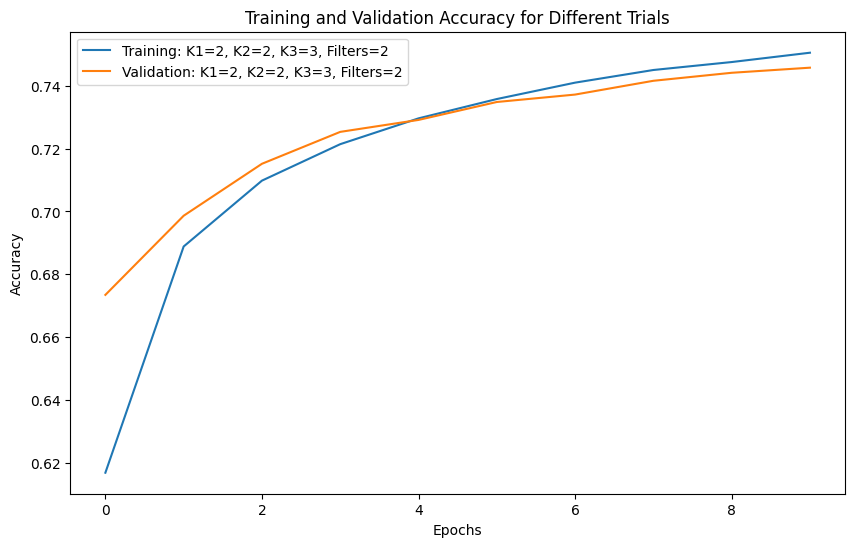

In [ ]:
train_and_plot_model(kernel_sizes1 = [2], kernel_sizes2 = [2], kernel_sizes3 = [3], num_filters_list = [2])

Epoch 1/10
2038/2038 [==============================] - 15s 6ms/step - loss: 0.8585 - accuracy: 0.6022 - val_loss: 0.7732 - val_accuracy: 0.6625
Epoch 2/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.7441 - accuracy: 0.6772 - val_loss: 0.7296 - val_accuracy: 0.6845
Epoch 3/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.7133 - accuracy: 0.6958 - val_loss: 0.7096 - val_accuracy: 0.6971
Epoch 4/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.6949 - accuracy: 0.7062 - val_loss: 0.6950 - val_accuracy: 0.7080
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6824 - accuracy: 0.7147 - val_loss: 0.6885 - val_accuracy: 0.7131
Epoch 6/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.6721 - accuracy: 0.7208 - val_loss: 0.6792 - val_accuracy: 0.7183
Epoch 7/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6623 - accuracy: 0.7289 - val_loss: 0.6649 - val_ac

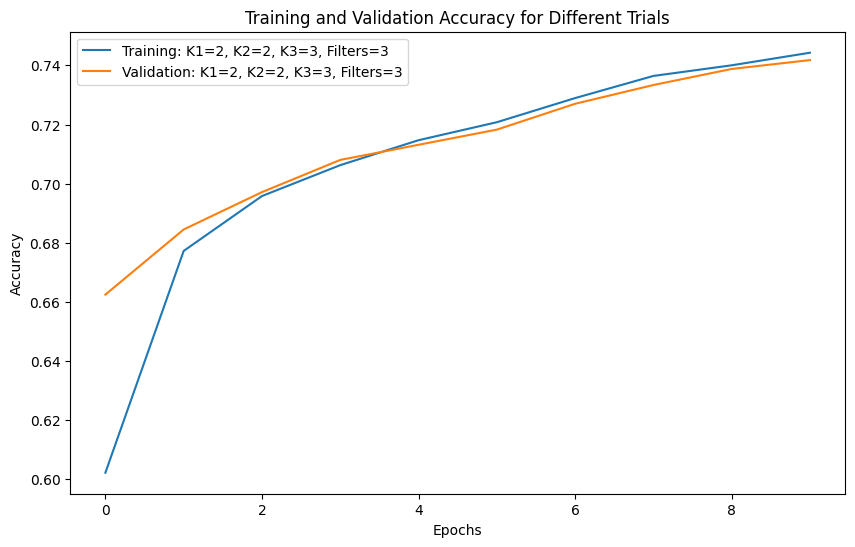

In [ ]:
train_and_plot_model(kernel_sizes1 = [2], kernel_sizes2 = [2], kernel_sizes3 = [3], num_filters_list = [3])

Epoch 1/10
2038/2038 [==============================] - 24s 6ms/step - loss: 0.8589 - accuracy: 0.6036 - val_loss: 0.7761 - val_accuracy: 0.6556
Epoch 2/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.7462 - accuracy: 0.6754 - val_loss: 0.7340 - val_accuracy: 0.6814
Epoch 3/10
2038/2038 [==============================] - 11s 5ms/step - loss: 0.7117 - accuracy: 0.6959 - val_loss: 0.7055 - val_accuracy: 0.6996
Epoch 4/10
2038/2038 [==============================] - 11s 6ms/step - loss: 0.6918 - accuracy: 0.7095 - val_loss: 0.6945 - val_accuracy: 0.7070
Epoch 5/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6783 - accuracy: 0.7184 - val_loss: 0.6807 - val_accuracy: 0.7147
Epoch 6/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6670 - accuracy: 0.7259 - val_loss: 0.6783 - val_accuracy: 0.7215
Epoch 7/10
2038/2038 [==============================] - 12s 6ms/step - loss: 0.6591 - accuracy: 0.7298 - val_loss: 0.6660 - val_ac

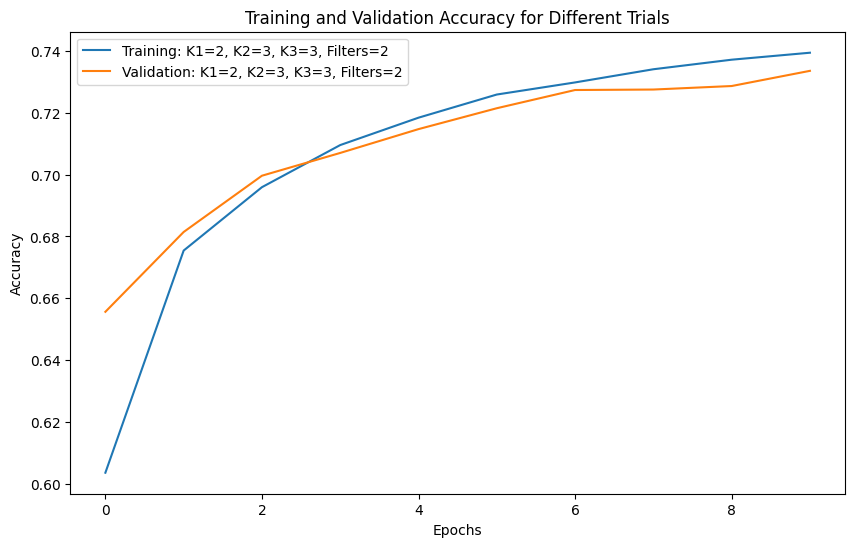

In [ ]:
train_and_plot_model(kernel_sizes1 = [2], kernel_sizes2 = [3], kernel_sizes3 = [3], num_filters_list = [2])

# **Conclusion**

| Model Configuration                 | Training Accuracy | Validation Accuracy |
|--------------------------------------|-------------------|----------------------|
| K1=2, K2=3, K3=4, Filters=2           | 70.82%            | 70.61%               |
| K1=2, K2=4, K3=5, Filters=2           | 73.77%            | 73.38%               |
| K1=2, K2=4, K3=6, Filters=2           | 74.30%            | 73.67%               |
| K1=2, K2=4, K3=6, Filters=3           | 73.32%            | 72.83%               |
| K1=4, K2=6, K3=8, Filters=2           | 71.62%            | 70.63%               |
| K1=4, K2=5, K3=6, Filters=2           | 70.50%            | 70.37%               |
| K1=2, K2=2, K3=3, Filters=2           | 75.05%            | 74.58%               |
| K1=2, K2=2, K3=3, Filters=3           | 74.43%            | 74.18%               |
| K1=2, K2=3, K3=3, Filters=2           | 73.94%            | 73.35%               |


The Highest Accuracy was obtained when using

K1=2, K2=2, K3=3, Filters=2

In [ ]:
model=train_and_plot_model(kernel_sizes1 = [2], kernel_sizes2 = [2], kernel_sizes3 = [3], num_filters_list = [2])

In [ ]:
X_test_seq_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/X_test_seq.npy')
y_test_loaded = np.load('/content/drive/MyDrive/zetsobu_drive/y_test.npy')


In [ ]:
yy=df['category']
yy

0        -1.0
1         0.0
2         1.0
3         1.0
4         1.0
         ... 
162975   -1.0
162976   -1.0
162977    0.0
162978    0.0
162979    1.0
Name: category, Length: 162969, dtype: float64

In [ ]:
le = LabelEncoder()
yy = le.fit_transform(yy)
yy

array([0, 1, 2, ..., 1, 1, 2])

1019/1019 [==============================] - 4s 3ms/step
Accuracy: 0.74
Classification Report:
               precision    recall  f1-score   support

    Negative       0.73      0.52      0.61      7152
     Neutral       0.70      0.87      0.78     11067
    Positive       0.79      0.76      0.77     14375

    accuracy                           0.74     32594
   macro avg       0.74      0.72      0.72     32594
weighted avg       0.75      0.74      0.74     32594



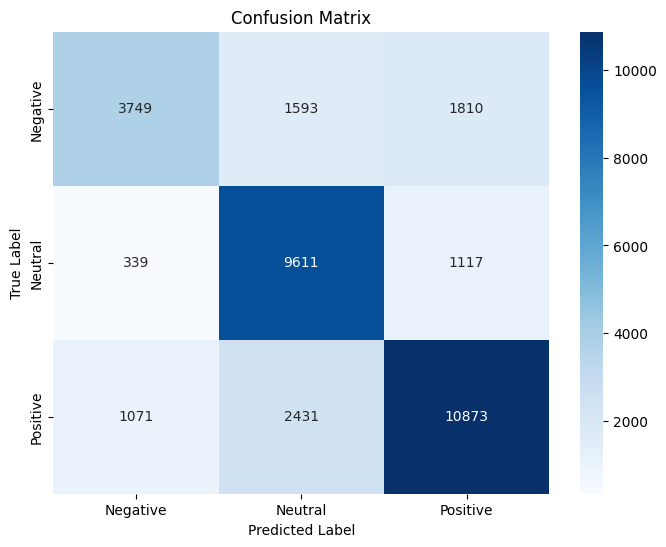

In [ ]:
def map_labels(labels):
    return np.where(labels == -1, 'Negative', np.where(labels == 0, 'Neutral', 'Positive'))

y_pred_prob = model.predict(X_test_seq_loaded)
y_pred = np.argmax(y_pred_prob, axis=1)

y_pred_labels = map_labels(le.inverse_transform(y_pred))
y_test_labels = map_labels(le.inverse_transform(y_test_loaded))

accuracy = accuracy_score(y_test_loaded, y_pred)
print(f"Accuracy: {accuracy:.2f}")

print("Classification Report:\n", classification_report(y_test_labels, y_pred_labels))

conf_matrix = confusion_matrix(y_test_labels, y_pred_labels, labels=['Negative', 'Neutral', 'Positive'])

plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=['Negative', 'Neutral', 'Positive'], yticklabels=['Negative', 'Neutral', 'Positive'])
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()
